---
# Crime Scene: NYC 2015-2018
---
## 1 Introduction

### 1.1 Background

In ordinary language, a crime is an unlawful act punishable by a state or other authority. The term crime does not, in modern criminal law, have any simple and universally accepted definition. The most popular view is that crime is a category created by law; in other words, something is a crime if declared as such by the relevant and applicable law.
The state has the power to restrict one's liberty for committing a crime. In modern societies, there are procedures to which investigations and trials must adhere. Law-enforcement authority which investigates the crimes is the police. The police are a constituted body of persons empowered by a state to enforce the law, to ensure the safety, health and possessions of citizens, and to prevent crime and civil disorder. Police accepts the complaints of crimes, these complaints will be a subject of this survey.
The goal of this survey is to explore the crime statistics of NY City, to compare the neighborhoods by their safety and to select the most dangerous and most safe place in NY.

### 1.2 Problem
Estimating the safety of the neighborhood may be valuable for real-estate agencies, business owners and of course for the tourists or people who looking for property in NY.

## 2 Data Acquisition and Cleaning
### 2.1 Data Sources
The [set of crime report headers](https://data.cityofnewyork.us/Public-Safety/NYPD-Complaint-Data-Historic/qgea-i56i) is provided by the New York City Police Department, the Department of Information Technology and Telecommunications and the Mayor’s Office of Data Analytics.
Main source of data is NYPD historic dataset. It includes all valid felony, misdemeanor, and violation crimes reported to the New York City Police Department (NYPD) from 2006 to the end of 2018. Today this dataset contains the records for more than 6.8 millions of accidents.

Other source of data will be [Foursquare.com](https://foursquare.com/). It will provide the information about business activity in the neighboorhoods under survey.

Dataset will be processed using _Python/pandas_ and presented on _Python/Folium_ maps.

In [1]:
import pandas as pd
import numpy as np
import folium
import seaborn
import geojson
import requests
from shapely.geometry import shape, Point
#from folium.plugins import HeatMap
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors

In [2]:
with open('Neighborhood Tabulation Areas (NTA).geojson') as f:
    geodata = f.read()
with open('Neighborhood Tabulation Areas (NTA).geojson') as f:
    nta_json = geojson.load(f)

In [3]:
df = pd.read_csv("rows2.csv",  dtype='unicode')

### 2.2 Data cleaning

This dataset contains a large quantity of data which will be excess for this work. After the brief reflection the shape of dataset was chosen as: the date of report, the coordinates of the accident, and the short description of accident. The rest of the data was omitted. The data before year 2015 was also omitted as irrelevent to our days. There was insighificant numer of broken records, e.g. without the date of report and/or coordinates, these records were also discarded.

This sequence of operations gave reduced the initial data to ~1.91 million of simplified records.

Initial offense descriptions had 67 unique categories.
These categories were reduced to 7 main categories by the subject of crime. This simplified categories include:
* Theft: the crimes that assumes the silent stealing of property; 
* Violent crimes: the crimes against person by use of force, weapons and threats;
* Acts of Disorder: the violations against public and administrative activities;
* Drug-related crimes: posession of drugs, being under drugs, etc;
* Sex-related: prostitution and and other non-violent;
* Vehicle-related violations: traffic violations, accidents, intoxicated driving;
* Miscellaneous: gambling, agriculture violations(?), fortune telling(seriously?), and others hard to classify.

In [4]:
df = df.drop(columns=['PD_CD','PD_DESC','PREM_TYP_DESC','JURIS_DESC','JURISDICTION_CODE','LAW_CAT_CD','KY_CD','PARKS_NM','HADEVELOPT','HOUSING_PSA','X_COORD_CD','Y_COORD_CD','VIC_AGE_GROUP','VIC_RACE','VIC_SEX','SUSP_AGE_GROUP','LOC_OF_OCCUR_DESC','CRM_ATPT_CPTD_CD','ADDR_PCT_CD','BORO_NM','SUSP_RACE','TRANSIT_DISTRICT', 'SUSP_SEX', 'Lat_Lon','PATROL_BORO','STATION_NAME','CMPLNT_FR_DT','CMPLNT_FR_TM','CMPLNT_TO_DT','CMPLNT_TO_TM'])

In [5]:
df = df.dropna(subset=['OFNS_DESC'])
len(df['OFNS_DESC'].unique())

67

In [6]:
print(df.shape)
df.head()

(1914179, 7)


,CMPLNT_NUM,RPT_DT,OFNS_DESC,Latitude,Longitude,BORO,NTA
0,350781553,05/10/2017,PETIT LARCENY,40.728613463,-73.707969285,Queens,Glen Oaks-Floral Park-New Hyde Park
1,297644403,06/30/2016,CRIMINAL MISCHIEF & RELATED OF,40.832941761,-73.935432593,Manhattan,Central Harlem North-Polo Grounds
2,455187251,08/06/2018,PETIT LARCENY,40.690015215000074,-73.98372074899999,Brooklyn,DUMBO-Vinegar Hill-Downtown Brooklyn-Boerum Hill
3,228818877,02/14/2018,BURGLARY,40.57729524400003,-74.14057114899998,Staten Island,Todt Hill-Emerson Hill-Heartland Village-Light...
4,948973342,02/20/2018,FORGERY,40.83284493600007,-73.913342415,Bronx,East Concourse-Concourse Village


In [7]:
df['RPT_DT'] = pd.to_datetime(df['RPT_DT']) # date transformation

In [8]:
period = (df['RPT_DT'].max()-df['RPT_DT'].min()).days / 365.25

In [9]:
df['Latitude'] = df['Latitude'].astype('float')
df['Longitude'] = df['Longitude'].astype('float')
center_lat = df['Latitude'].mean()
center_lon = df['Longitude'].mean()

In [10]:
df['CRIME_TYPE']=df['OFNS_DESC']

#Theft 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'PETIT LARCENY':'Theft'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'FORGERY':'Theft'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'GRAND LARCENY OF MOTOR VEHICLE':'Theft'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'POSSESSION OF STOLEN PROPERTY':'Theft'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'FRAUDULENT ACCOSTING':'Theft'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'BURGLARY':'Theft'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'GRAND LARCENY':'Theft'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'THEFT OF SERVICES':'Theft'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'THEFT-FRAUD':'Theft'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'PETIT LARCENY OF MOTOR VEHICLE':'Theft'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'FRAUDS':'Theft'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'OFFENSES INVOLVING FRAUD':'Theft'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'CRIMINAL TRESPASS':'Theft'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'OTHER OFFENSES RELATED TO THEF':'Theft'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({"BURGLAR'S TOOLS":'Theft'}) 

# Arson!!!
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'ARSON':'Arson'})

 
#Vehicle 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'UNAUTHORIZED USE OF A VEHICLE':'Vehicle'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'VEHICLE AND TRAFFIC LAWS':'Vehicle'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'OTHER TRAFFIC INFRACTION':'Vehicle'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'INTOXICATED/IMPAIRED DRIVING':'Vehicle'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'HOMICIDE-NEGLIGENT-VEHICLE':'Vehicle'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'INTOXICATED & IMPAIRED DRIVING':'Vehicle'}) 
 
#Sex 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'PROSTITUTION & RELATED OFFENSES':'Sex-related'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'SEX CRIMES':'Sex-related'}) 
 
#Violence
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'RAPE':'Violence'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'OFFENSES AGAINST THE PERSON':'Violence'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'HARRASSMENT 2':'Violence'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'ASSAULT 3 & RELATED OFFENSES':'Violence'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'FELONY ASSAULT':'Violence'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'ROBBERY':'Violence'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'KIDNAPPING':'Violence'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'KIDNAPPING AND RELATED OFFENSES':'Violence'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'JOSTLING':'Violence'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'OFFENSES RELATED TO CHILDREN':'Violence'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'KIDNAPPING & RELATED OFFENSES':'Violence'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'MURDER & NON-NEGL. MANSLAUGHTER':'Violence'})
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'HOMICIDE-NEGLIGENT,UNCLASSIFIE':'Violence'})
 
#Drugs 
 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'DANGEROUS DRUGS':'Drug-related'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'ALCOHOLIC BEVERAGE CONTROL LAW':'Drug-related'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'UNDER THE INFLUENCE OF Drug-related':'Drug-related'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'UNDER THE INFLUENCE OF DRUGS':'Drug-related'}) 
 
#Disorder 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'OFF. AGNST PUB ORD SENSBLTY &':'Disorder'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'OFFENSES AGAINST PUBLIC ADMINI':'Disorder'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'ADMINISTRATIVE CODE':'Disorder'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'LOITERING':'Disorder'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'DISRUPTION OF A RELIGIOUS SERV':'Disorder'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'OFFENSES AGAINST PUBLIC SAFETY':'Disorder'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'ADMINISTRATIVE CODES':'Disorder'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'CRIMINAL MISCHIEF & RELATED OF':'Disorder'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'UNLAWFUL POSS. WEAP. ON SCHOOL':'Disorder'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'NEW YORK CITY HEALTH CODE':'Disorder'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'DISORDERLY CONDUCT':'Disorder'}) 
 
#Miscelaneous 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'MISCELLANEOUS PENAL LAW':'Miscellaneous'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'DANGEROUS WEAPONS':'Miscellaneous'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'NYS LAWS-UNCLASSIFIED FELONY':'Miscellaneous'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'OTHER STATE LAWS (NON PENAL LA':'Miscellaneous'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'CHILD ABANDONMENT/NON SUPPORT':'Miscellaneous'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'GAMBLING':'Miscellaneous'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'AGRICULTURE & MRKTS LAW-UNCLASSIFIED':'Miscellaneous'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'OTHER STATE LAWS':'Miscellaneous'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'LOITERING/GAMBLING (CARDS, DIC':'Miscellaneous'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'ENDAN WELFARE INCOMP':'Miscellaneous'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'NYS LAWS-UNCLASSIFIED VIOLATION':'Miscellaneous'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'ABORTION':'Miscellaneous'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'ANTICIPATORY OFFENSES':'Miscellaneous'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'OTHER STATE LAWS (NON PENAL LAW)':'Miscellaneous'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'FORTUNE TELLING':'Miscellaneous'}) 
df['CRIME_TYPE'] = df['CRIME_TYPE'].replace({'ESCAPE 3':'Miscellaneous'})    

In [11]:
df['CRIME_TYPE'].unique()

array(['Theft', 'Disorder', 'Violence', 'Drug-related', 'Miscellaneous',
       'Vehicle', 'Sex-related', 'Arson'], dtype=object)

In [12]:
nta_list = {'NTA':[], 'BORO':[], 'AREA':[], 'Latitude':[], 'Longitude':[]}

for feature in nta_json['features']:
    nta_list['BORO'].append(feature.properties['boro_name'])
    nta_list['NTA'].append(feature.properties['ntaname'])
    nta_list['AREA'].append(float(feature.properties['shape_area'])/27878400)
    polygon = shape(feature['geometry'])
    nta_list['Latitude'].append(polygon.centroid.y)
    nta_list['Longitude'].append(polygon.centroid.x)
    
df_nh = pd.DataFrame.from_dict(nta_list)
df_nh


,NTA,BORO,AREA,Latitude,Longitude
0,Borough Park,Brooklyn,1.937164,40.630950,-73.988661
1,Murray Hill,Queens,1.882758,40.768352,-73.809546
2,East Elmhurst,Queens,0.707603,40.763352,-73.868396
3,Hollis,Queens,0.820986,40.710639,-73.761137
4,Manhattanville,Manhattan,0.381911,40.817976,-73.953782
...,...,...,...,...,...
190,Ozone Park,Queens,0.897356,40.675599,-73.847049
191,Lindenwood-Howard Beach,Queens,2.315734,40.658170,-73.844885
192,University Heights-Morris Heights,Bronx,0.762436,40.852522,-73.915974
193,New Brighton-Silver Lake,Staten Island,1.690816,40.630050,-74.102861


In [13]:
df_by_nh = df.groupby(['NTA'])['NTA'].count().reset_index(name='Total number of crimes')
df_nh = pd.merge(df_nh, df_by_nh, on="NTA", how ="outer")

df_nh['Total number of crimes'].fillna(0.0, inplace = True)
df_nh['Crime density'] = df_nh['Total number of crimes'].astype('float') / (df_nh['AREA'] * period)
df_nh

,NTA,BORO,AREA,Latitude,Longitude,Total number of crimes,Crime density
0,Borough Park,Brooklyn,1.937164,40.630950,-73.988661,8245,945.611604
1,Murray Hill,Queens,1.882758,40.768352,-73.809546,4746,560.043378
2,East Elmhurst,Queens,0.707603,40.763352,-73.868396,4533,1423.260281
3,Hollis,Queens,0.820986,40.710639,-73.761137,3780,1022.926716
4,Manhattanville,Manhattan,0.381911,40.817976,-73.953782,8370,4869.129195
...,...,...,...,...,...,...,...
190,Ozone Park,Queens,0.897356,40.675599,-73.847049,4185,1036.142009
191,Lindenwood-Howard Beach,Queens,2.315734,40.658170,-73.844885,3514,337.133243
192,University Heights-Morris Heights,Bronx,0.762436,40.852522,-73.915974,14217,4142.792596
193,New Brighton-Silver Lake,Staten Island,1.690816,40.630050,-74.102861,3514,461.736096


In [217]:
crime_map = folium.Map(location=[center_lat, center_lon], tiles='cartodbpositron', zoom_start=10.5)

folium.Choropleth(
    geo_data=geodata,
    data=df_nh,
    columns=['NTA', 'Crime density'],
    key_on='feature.properties.ntaname',
    fill_color='YlOrRd',
    fill_opacity=0.6, 
    line_opacity=0.2,
    legend_name='Crimes per square mile per year',
    highlight = True
).add_to(crime_map)


for lat, lng, nta, boro, density in zip(df_nh['Latitude'], df_nh['Longitude'], 
                                  df_nh['NTA'], df_nh['BORO'], 
                                  df_nh['Crime density']):
    color = 'brown'
    label = "{}, {}. \n {:.2f} crimes per sq mile in year".format(nta, boro, density)
    label = "<b>{}, {}</b><br/>{} violations per sq mile per year".format(nta, boro, int(density))
    label = folium.Html(label, script=True)
    label = folium.Popup(label, parse_html=True,max_width=500)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color=color,
        fill=True,
        fill_color=color,
        opacity=0.1,
        fill_opacity=0.0,
        parse_html=False).add_to(crime_map)  
crime_map.save(outfile="total.html")
crime_map

In [15]:
c = df_nh[['BORO', 'NTA', 'Total number of crimes', 'Crime density']].sort_values(by='Crime density', ascending = False).head()
c

,BORO,NTA,Total number of crimes,Crime density
83,Manhattan,Midtown-Midtown South,48021,9851.497946
178,Manhattan,Central Harlem South,21395,9177.455093
127,Bronx,Fordham South,8838,8676.774612
114,Bronx,Melrose South-Mott Haven North,22065,7912.670333
121,Manhattan,Gramercy,9040,7438.870552


Midtown of Manhattan looks like the lair of The Evil of NY City. What are the most advanced criminal skills of all these guys?

In [16]:
c.index

Int64Index([83, 178, 127, 114, 121], dtype='int64')

In [17]:
cc = c['NTA'].to_list()
champs = df[df['NTA'].isin(cc)]

In [18]:
#df.pivot(index='NTA', columns='CRIME_TYPE')
#pd.pivot_table(df, values=df['CRIME_TYPE'], index=df['NTA'], columns=['CRIME_TYPE'], aggfunc='count')
pt=pd.pivot_table(champs[['CRIME_TYPE']],index=champs['NTA'], columns=champs['CRIME_TYPE'], aggfunc = 'count')
#pt.columns = pt.columns.get_level_values(1)
pt.fillna(0.0, inplace=True)
pt.columns=pt.columns.droplevel(0)

pt['Total']=pt.sum(axis=1, numeric_only=True)

pt.columns = pt.columns.values
pt.index = pt.index.values
pt.drop('Arson', axis=1, inplace=True)
pt


,Disorder,Drug-related,Miscellaneous,Sex-related,Theft,Vehicle,Violence,Total
Central Harlem South,3671.0,1719.0,823.0,265.0,8019.0,252.0,6625.0,21395.0
Fordham South,1310.0,746.0,389.0,1.0,2455.0,92.0,3833.0,8838.0
Gramercy,1101.0,126.0,579.0,633.0,4322.0,187.0,2091.0,9040.0
Melrose South-Mott Haven North,3380.0,2298.0,1175.0,0.0,6677.0,292.0,8185.0,22065.0
Midtown-Midtown South,3965.0,971.0,884.0,10.0,32876.0,554.0,8747.0,48021.0


In [19]:
pt = pt.sort_values(by='Total', ascending=False)
pt=pt.div(pt['Total'], axis=0)*100
pt.drop('Total', axis=1, inplace=True)
pt

,Disorder,Drug-related,Miscellaneous,Sex-related,Theft,Vehicle,Violence
Midtown-Midtown South,8.256804,2.022032,1.840861,0.020824,68.461715,1.153662,18.214948
Melrose South-Mott Haven North,15.318378,10.414684,5.325176,0.000000,30.260594,1.323363,37.094947
Central Harlem South,17.158215,8.034588,3.846693,1.238607,37.480720,1.177845,30.965179
Gramercy,12.179204,1.393805,6.404867,7.002212,47.809735,2.068584,23.130531
Fordham South,14.822358,8.440824,4.401448,0.011315,27.777778,1.040959,43.369541


In [20]:
#order=pt.sum().sort_values()
#order

pt=pt.reindex(pt.sum().sort_values(ascending = False).index, axis=1)
pt

,Theft,Violence,Disorder,Drug-related,Miscellaneous,Sex-related,Vehicle
Midtown-Midtown South,68.461715,18.214948,8.256804,2.022032,1.840861,0.020824,1.153662
Melrose South-Mott Haven North,30.260594,37.094947,15.318378,10.414684,5.325176,0.000000,1.323363
Central Harlem South,37.480720,30.965179,17.158215,8.034588,3.846693,1.238607,1.177845
Gramercy,47.809735,23.130531,12.179204,1.393805,6.404867,7.002212,2.068584
Fordham South,27.777778,43.369541,14.822358,8.440824,4.401448,0.011315,1.040959


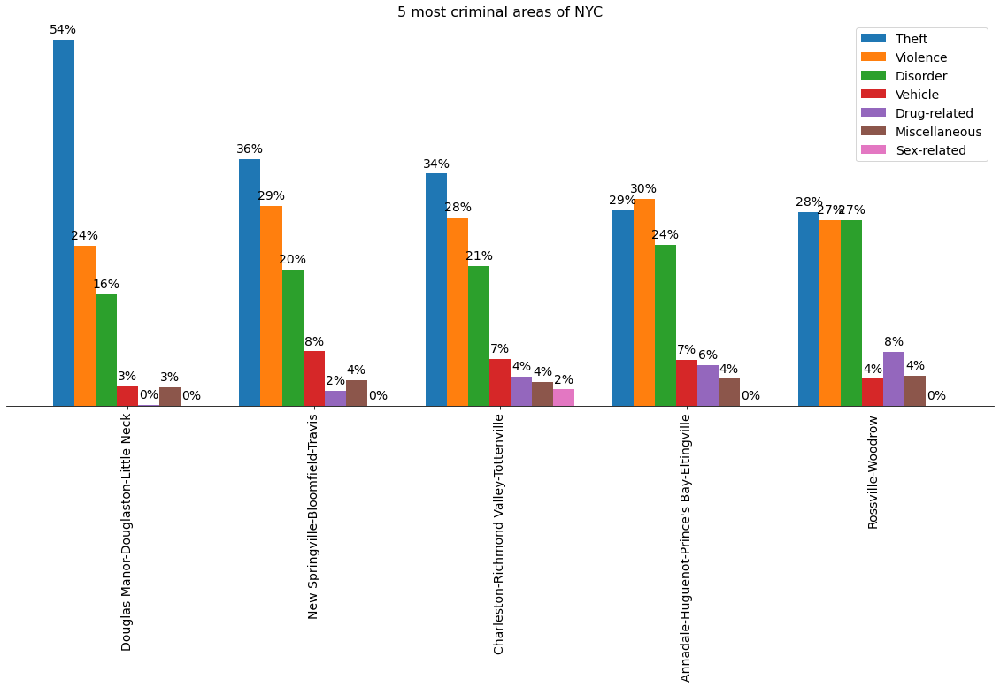

In [220]:
pt = pt.sort_values(by='Theft', ascending=False)
df_p = pt
ax = df_p.plot(kind='bar', figsize=(20, 8), width=0.8, fontsize = 14)
ax.legend(fontsize = 14)
ax.set_title('5 most criminal areas of NYC', fontsize = 16)
for patch in ax.patches:
    percentage = "{:.0f}%".format(patch.get_height())
    position = (patch.get_x() + patch.get_width()/2, patch.get_height() + 1)
    ax.annotate(percentage, xy = position, ha = 'center', fontsize = 14)
ax.yaxis.set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.savefig("most.png", bbox_inches="tight")

It revealed that more than 2/3 of Midtown crimes is the ordinary theft(remember, in this survey we assume the robbery is a violent crime and not a theft). Of course it doesn't look funny if somebody stole your cellphone and shoelaces, but this isn't an assault. At least you will be alive and in one piece, and your health insurance will stay untouched. Our 3rd top criminal area, Fordham South, have the similar crime rate per square mile, but the profile of Bronx guys is definitely more dangerous.

---

In [22]:
c = df_nh[['BORO', 'NTA', 'Total number of crimes', 'Crime density']].sort_values(by='Crime density').head(10)
#c=c.drop(c['NTA']=='Airport', inplace=True)
c.drop(c[c['NTA']=='Airport'].index, inplace = True)
c.drop(c[c['NTA'].str.contains('park-cemetery-etc')].index, inplace = True)
c

,BORO,NTA,Total number of crimes,Crime density
176,Staten Island,New Springville-Bloomfield-Travis,6037,114.080160
79,Staten Island,Annadale-Huguenot-Prince's Bay-Eltingville,2825,124.044536
106,Staten Island,Charleston-Richmond Valley-Tottenville,3971,168.838806
107,Staten Island,Rossville-Woodrow,1772,168.947399
99,Queens,Douglas Manor-Douglaston-Little Neck,1934,175.143346


Staten Island looks like the safest place in the entiry NY. Let's see what kind of crimes do they prefer to commit:

In [23]:
c.index

Int64Index([176, 79, 106, 107, 99], dtype='int64')

In [24]:
cc = c['NTA'].to_list()
champs = df[df['NTA'].isin(cc)]

In [25]:
#df.pivot(index='NTA', columns='CRIME_TYPE')
#pd.pivot_table(df, values=df['CRIME_TYPE'], index=df['NTA'], columns=['CRIME_TYPE'], aggfunc='count')
pt=pd.pivot_table(champs[['CRIME_TYPE']],index=champs['NTA'], columns=champs['CRIME_TYPE'], aggfunc = 'count')
#pt.columns = pt.columns.get_level_values(1)
pt.fillna(0.0, inplace=True)
pt.columns=pt.columns.droplevel(0)

pt['Total']=pt.sum(axis=1, numeric_only=True)

pt.columns = pt.columns.values
pt.index = pt.index.values
pt.drop('Arson', axis=1, inplace=True)
pt


,Disorder,Drug-related,Miscellaneous,Sex-related,Theft,Vehicle,Violence,Total
Annadale-Huguenot-Prince's Bay-Eltingville,671.0,171.0,113.0,0.0,813.0,192.0,861.0,2825.0
Charleston-Richmond Valley-Tottenville,819.0,173.0,140.0,97.0,1358.0,276.0,1100.0,3971.0
Douglas Manor-Douglaston-Little Neck,318.0,4.0,54.0,0.0,1042.0,56.0,457.0,1934.0
New Springville-Bloomfield-Travis,1209.0,136.0,228.0,0.0,2192.0,486.0,1777.0,6037.0
Rossville-Woodrow,485.0,142.0,79.0,0.0,505.0,71.0,484.0,1772.0


In [26]:
pt = pt.sort_values(by='Total', ascending=False)
pt=pt.div(pt['Total'], axis=0)*100
pt.drop('Total', axis=1, inplace=True)
pt

,Disorder,Drug-related,Miscellaneous,Sex-related,Theft,Vehicle,Violence
New Springville-Bloomfield-Travis,20.026503,2.252775,3.776710,0.00000,36.309425,8.050356,29.435150
Charleston-Richmond Valley-Tottenville,20.624528,4.356585,3.525560,2.44271,34.197935,6.950390,27.700831
Annadale-Huguenot-Prince's Bay-Eltingville,23.752212,6.053097,4.000000,0.00000,28.778761,6.796460,30.477876
Douglas Manor-Douglaston-Little Neck,16.442606,0.206825,2.792141,0.00000,53.877973,2.895553,23.629783
Rossville-Woodrow,27.370203,8.013544,4.458239,0.00000,28.498871,4.006772,27.313770


In [232]:
#order=pt.sum().sort_values()
#order

pt=pt.reindex(pt.sum().sort_values(ascending = False).index, axis=1)
pt

,Theft,Violence,Disorder,Vehicle,Drug-related,Miscellaneous,Sex-related
Douglas Manor-Douglaston-Little Neck,53.877973,23.629783,16.442606,2.895553,0.206825,2.792141,0.00000
New Springville-Bloomfield-Travis,36.309425,29.435150,20.026503,8.050356,2.252775,3.776710,0.00000
Charleston-Richmond Valley-Tottenville,34.197935,27.700831,20.624528,6.950390,4.356585,3.525560,2.44271
Annadale-Huguenot-Prince's Bay-Eltingville,28.778761,30.477876,23.752212,6.796460,6.053097,4.000000,0.00000
Rossville-Woodrow,28.498871,27.313770,27.370203,4.006772,8.013544,4.458239,0.00000


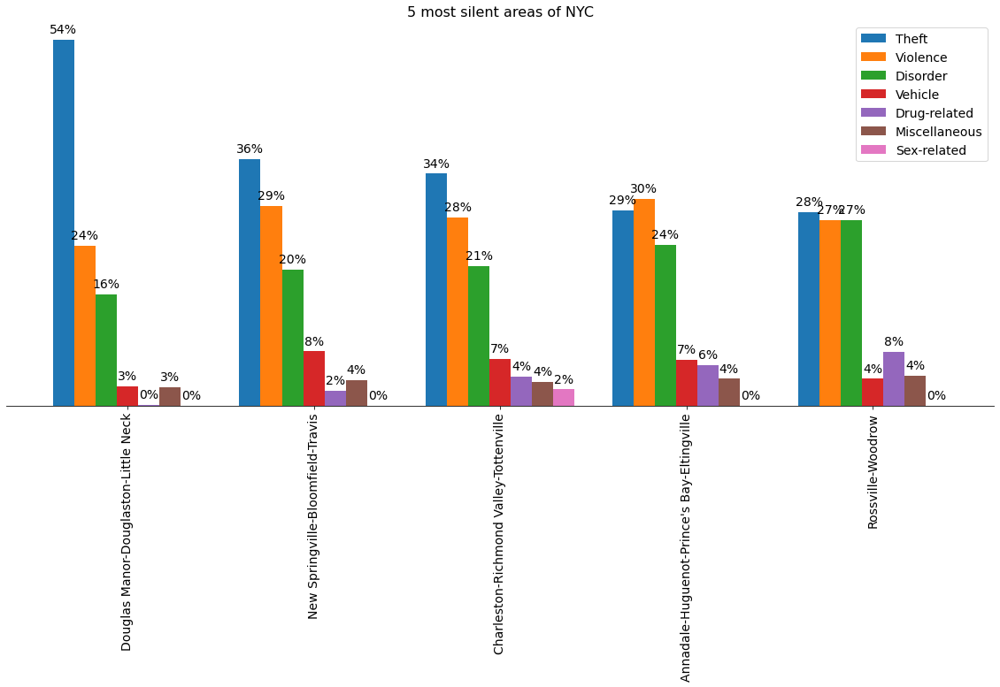

In [221]:
pt = pt.sort_values(by='Theft', ascending=False)
df_p = pt
ax = df_p.plot(kind='bar', figsize=(20, 8), width=0.8, fontsize = 14)
ax.legend(fontsize = 14)
ax.set_title('5 most silent areas of NYC', fontsize = 16)
for patch in ax.patches:
    percentage = "{:.0f}%".format(patch.get_height())
    position = (patch.get_x() + patch.get_width()/2, patch.get_height() + 1)
    ax.annotate(percentage, xy = position, ha = 'center', fontsize = 14)
ax.yaxis.set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.savefig("safest.png", bbox_inches="tight")

These thiefs from Queens disrupted all the statistics! However it is clear the people of Staten Island are not the same as Manhattan guys. Traffic violations were almost invisible in Bronx, but here it is 7-8%! Does that mean all the Staten is driving like nuts? More likely these people don't committing so much of other crimes, so the vehicle violations became the significant part... of almost nothing. If the citizen of ~~Silent~~ Staten Island decides to go bad, he is more into make some disorder. If he knocks over the dumpster, will it be too much? And there are no sex crimes in Staten. Maybe there is no sex at all.

---

Let's check which crimes are the most common in the entire NYC.

In [29]:
common = df.groupby(['CRIME_TYPE'])['CRIME_TYPE'].count().reset_index(name='Crime Count')
common=common.sort_values(by='Crime Count', ascending = False)
common

,CRIME_TYPE,Crime Count
5,Theft,684618
7,Violence,637387
1,Disorder,322852
3,Miscellaneous,98511
2,Drug-related,84602
6,Vehicle,56074
4,Sex-related,26861
0,Arson,3274


Now it's pretty clear that the 3 most common criminal cases are the Theft, the Violence, and the Disorder. Let's dive into this a little bit deeper.

---
## Theft
---

In [30]:
df_t=df[df['CRIME_TYPE']=='Theft']
df_by_nh = df_t.groupby(['NTA'])['NTA'].count().reset_index(name='Thefts Count')
df_by_nh

,NTA,Thefts Count
0,Airport,40
1,Allerton-Pelham Gardens,1395
2,Annadale-Huguenot-Prince's Bay-Eltingville,813
3,Arden Heights,458
4,Astoria,5429
...,...,...
190,park-cemetery-etc-Bronx,1860
191,park-cemetery-etc-Brooklyn,1368
192,park-cemetery-etc-Manhattan,2029
193,park-cemetery-etc-Queens,1413


In [31]:
df_nh = pd.merge(df_nh, df_by_nh, on="NTA", how ="outer")
#df_nh['Arsons density'] = df_nh['Arsons count'] / df_nh['AREA']
df_nh

,NTA,BORO,AREA,Latitude,Longitude,Total number of crimes,Crime density,Thefts Count
0,Borough Park,Brooklyn,1.937164,40.630950,-73.988661,8245,945.611604,3289
1,Murray Hill,Queens,1.882758,40.768352,-73.809546,4746,560.043378,1771
2,East Elmhurst,Queens,0.707603,40.763352,-73.868396,4533,1423.260281,1392
3,Hollis,Queens,0.820986,40.710639,-73.761137,3780,1022.926716,1053
4,Manhattanville,Manhattan,0.381911,40.817976,-73.953782,8370,4869.129195,2351
...,...,...,...,...,...,...,...,...
190,Ozone Park,Queens,0.897356,40.675599,-73.847049,4185,1036.142009,1758
191,Lindenwood-Howard Beach,Queens,2.315734,40.658170,-73.844885,3514,337.133243,1504
192,University Heights-Morris Heights,Bronx,0.762436,40.852522,-73.915974,14217,4142.792596,3448
193,New Brighton-Silver Lake,Staten Island,1.690816,40.630050,-74.102861,3514,461.736096,1091


In [32]:
df_nh['Thefts Count'].fillna(0.0, inplace = True)
df_nh['Thefts density'] = df_nh['Thefts Count'].astype('float') / (df_nh['AREA'] * period)
df_nh.sort_values(by='Thefts density').head(10)

,NTA,BORO,AREA,Latitude,Longitude,Total number of crimes,Crime density,Thefts Count,Thefts density
50,park-cemetery-etc-Staten Island,Staten Island,0.861042,40.546587,-74.126355,21,5.418553,2,0.516053
170,Airport,Queens,8.185520,40.664620,-73.798625,179,4.858421,40,1.085681
73,Rikers Island,Bronx,0.651538,40.791130,-73.882655,5108,1741.805968,77,26.256668
186,park-cemetery-etc-Queens,Queens,11.180301,40.689594,-73.831486,3364,66.848384,1413,28.078706
79,Annadale-Huguenot-Prince's Bay-Eltingville,Staten Island,5.059752,40.528667,-74.187700,2825,124.044536,813,35.698481
151,park-cemetery-etc-Brooklyn,Brooklyn,8.208484,40.623140,-73.918565,3913,105.909590,1368,37.026404
176,New Springville-Bloomfield-Travis,Staten Island,11.757080,40.595928,-74.176390,6037,114.080160,2192,41.421850
107,Rossville-Woodrow,Staten Island,2.330240,40.540334,-74.207828,1772,168.947399,505,48.148102
153,park-cemetery-etc-Bronx,Bronx,7.921585,40.872460,-73.848118,5900,165.473463,1860,52.166210
65,Arden Heights,Staten Island,1.808239,40.552659,-74.188483,1687,207.275329,458,56.272733


In [223]:
ny_thefts_map = folium.Map([center_lat, center_lon], tiles='cartodbpositron', zoom_start=10.5)

folium.Choropleth(
    geo_data=geodata,
    data=df_nh,
    columns=['NTA', 'Thefts density'],
    key_on='feature.properties.ntaname',
    fill_color='YlOrRd',
    fill_opacity=0.6, 
    line_opacity=0.2,
    legend_name='Thefts per square mile per year',
    highlight = True
).add_to(ny_thefts_map)


for lat, lng, nta, boro, density in zip(df_nh['Latitude'], df_nh['Longitude'], 
                                  df_nh['NTA'], df_nh['BORO'], 
                                  df_nh['Thefts density']):
    color = 'brown'
    label = "<b>{}, {}</b><br/>{} thefts per sq mile per year".format(nta, boro, int(density))
    label = folium.Html(label, script=True)
    label = folium.Popup(label, parse_html=True,max_width=500)
    folium.CircleMarker(
        [lat, lng], 
        radius=4, 
        popup=label, 
        color=color, 
        fill=True, 
        fill_color=color, 
        opacity=0.1, 
        fill_opacity=0.0,
        parse_html=False).add_to(ny_thefts_map)  
ny_thefts_map.save(outfile="thefts.html")
    
ny_thefts_map

Yes. The Department of Stealh Disposal of Unnecessary Objects is headquartered in Midtown, Manhattan. We already know it.

The safest area is Staten Island. 50-100 stealings per year.

---

## Violence

---



In [34]:
df_t=df[df['CRIME_TYPE']=='Violence']
df_by_nh = df_t.groupby(['NTA'])['NTA'].count().reset_index(name='Violence Count')
df_by_nh

,NTA,Violence Count
0,Airport,26
1,Allerton-Pelham Gardens,1546
2,Annadale-Huguenot-Prince's Bay-Eltingville,861
3,Arden Heights,565
4,Astoria,4824
...,...,...
190,park-cemetery-etc-Bronx,1834
191,park-cemetery-etc-Brooklyn,1067
192,park-cemetery-etc-Manhattan,1603
193,park-cemetery-etc-Queens,709


In [35]:
df_nh = pd.merge(df_nh, df_by_nh, on="NTA", how ="outer")
#df_nh['Arsons density'] = df_nh['Arsons count'] / df_nh['AREA']
df_nh

,NTA,BORO,AREA,Latitude,Longitude,Total number of crimes,Crime density,Thefts Count,Thefts density,Violence Count
0,Borough Park,Brooklyn,1.937164,40.630950,-73.988661,8245,945.611604,3289,377.212440,2245
1,Murray Hill,Queens,1.882758,40.768352,-73.809546,4746,560.043378,1771,208.983738,1731
2,East Elmhurst,Queens,0.707603,40.763352,-73.868396,4533,1423.260281,1392,437.056764,1751
3,Hollis,Queens,0.820986,40.710639,-73.761137,3780,1022.926716,1053,284.958157,1479
4,Manhattanville,Manhattan,0.381911,40.817976,-73.953782,8370,4869.129195,2351,1367.661020,2788
...,...,...,...,...,...,...,...,...,...,...
190,Ozone Park,Queens,0.897356,40.675599,-73.847049,4185,1036.142009,1758,435.253919,1222
191,Lindenwood-Howard Beach,Queens,2.315734,40.658170,-73.844885,3514,337.133243,1504,144.293796,963
192,University Heights-Morris Heights,Bronx,0.762436,40.852522,-73.915974,14217,4142.792596,3448,1004.737207,6399
193,New Brighton-Silver Lake,Staten Island,1.690816,40.630050,-74.102861,3514,461.736096,1091,143.356312,1278


In [36]:
df_nh['Violence Count'].fillna(0.0, inplace = True)
df_nh['Violence density'] = df_nh['Violence Count'].astype('float') / (df_nh['AREA'] * period)
df_nh[df_nh['Violence Count'].isnull()]

,NTA,BORO,AREA,Latitude,Longitude,Total number of crimes,Crime density,Thefts Count,Thefts density,Violence Count,Violence density


In [225]:
ny_violence_map = folium.Map(location=[center_lat, center_lon], tiles='cartodbpositron', zoom_start=10.5)

folium.Choropleth(
    geo_data=geodata,
    data=df_nh,
    columns=['NTA', 'Violence density'],
    key_on='feature.properties.ntaname',
    fill_color='YlOrRd',
    fill_opacity=0.6, 
    line_opacity=0.2,
    legend_name='Acts of violence per square mile per year',
    highlight = True
).add_to(ny_violence_map)


for lat, lng, nta, boro, density in zip(df_nh['Latitude'], df_nh['Longitude'], 
                                  df_nh['NTA'], df_nh['BORO'], 
                                  df_nh['Violence density']):
    color = 'brown'
    label = "<b>{}, {}</b><br/>{} acts of violence per sq mile per year".format(nta, boro, int(density))
    label = folium.Html(label, script=True)
    label = folium.Popup(label, parse_html=True,max_width=500)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color=color,
        fill=True,
        fill_color=color,
        opacity=0.1,
        fill_opacity=0.0,
        parse_html=False).add_to(ny_violence_map)  

ny_violence_map.save(outfile="violence.html") 
ny_violence_map

The leader in this nomination is Bronx. Fordham South is the NYC capital of everything related to violensce. At least 10 acts of violence per day per square mile. You better don't wander in the heart of Bronx. 

Central Harlem South is not very safe place too. That movie didn't lie.

Eastern part of Queens is the safest place in the NYC. But not as safe as Staten Island, of course.

---

## Disorder
---

This survey will use the word "disorder" for the acts against public order, for the criminal mischief, for the offenses against public adminictration, etc.

In [38]:
df_t=df[df['CRIME_TYPE']=='Disorder']
df_by_nh = df_t.groupby(['NTA'])['NTA'].count().reset_index(name='Acts of disorder Count')
df_by_nh

,NTA,Acts of disorder Count
0,Airport,13
1,Allerton-Pelham Gardens,911
2,Annadale-Huguenot-Prince's Bay-Eltingville,671
3,Arden Heights,444
4,Astoria,2465
...,...,...
190,park-cemetery-etc-Bronx,1219
191,park-cemetery-etc-Brooklyn,744
192,park-cemetery-etc-Manhattan,718
193,park-cemetery-etc-Queens,669


In [39]:
df_nh = pd.merge(df_nh, df_by_nh, on="NTA", how ="outer")
#df_nh['Arsons density'] = df_nh['Arsons count'] / df_nh['AREA']
df_nh

,NTA,BORO,AREA,Latitude,Longitude,Total number of crimes,Crime density,Thefts Count,Thefts density,Violence Count,Violence density,Acts of disorder Count
0,Borough Park,Brooklyn,1.937164,40.630950,-73.988661,8245,945.611604,3289,377.212440,2245,257.477022,1325
1,Murray Hill,Queens,1.882758,40.768352,-73.809546,4746,560.043378,1771,208.983738,1731,204.263609,850
2,East Elmhurst,Queens,0.707603,40.763352,-73.868396,4533,1423.260281,1392,437.056764,1751,549.774708,733
3,Hollis,Queens,0.820986,40.710639,-73.761137,3780,1022.926716,1053,284.958157,1479,400.240374,853
4,Manhattanville,Manhattan,0.381911,40.817976,-73.953782,8370,4869.129195,2351,1367.661020,2788,1621.879593,1800
...,...,...,...,...,...,...,...,...,...,...,...,...
190,Ozone Park,Queens,0.897356,40.675599,-73.847049,4185,1036.142009,1758,435.253919,1222,302.548515,815
191,Lindenwood-Howard Beach,Queens,2.315734,40.658170,-73.844885,3514,337.133243,1504,144.293796,963,92.390243,688
192,University Heights-Morris Heights,Bronx,0.762436,40.852522,-73.915974,14217,4142.792596,3448,1004.737207,6399,1864.650054,2640
193,New Brighton-Silver Lake,Staten Island,1.690816,40.630050,-74.102861,3514,461.736096,1091,143.356312,1278,167.927926,744


In [40]:
df_nh['Acts of disorder Count'].fillna(0.0, inplace = True)
df_nh['Disorder density'] = df_nh['Acts of disorder Count'].astype('float') / (df_nh['AREA'] * period)
df_nh[df_nh['Acts of disorder Count'].isnull()]

,NTA,BORO,AREA,Latitude,Longitude,Total number of crimes,Crime density,Thefts Count,Thefts density,Violence Count,Violence density,Acts of disorder Count,Disorder density


In [226]:
ny_disorder_map = folium.Map(location=[center_lat, center_lon], tiles='cartodbpositron', zoom_start=10.5)

folium.Choropleth(
    geo_data=geodata,
    data=df_nh,
    columns=['NTA', 'Disorder density'],
    key_on='feature.properties.ntaname',
    fill_color='YlOrRd',
    fill_opacity=0.6, 
    line_opacity=0.2,
    legend_name='Acts of disorder per square mile per year',
    highlight = True
).add_to(ny_disorder_map)


for lat, lng, nta, boro, density in zip(df_nh['Latitude'], df_nh['Longitude'], 
                                  df_nh['NTA'], df_nh['BORO'], 
                                  df_nh['Disorder density']):
    color = 'brown'
    label = "<b>{}, {}</b><br/>{} acts of disorder per sq mile per year".format(nta, boro, int(density))
    label = folium.Html(label, script=True)
    label = folium.Popup(label, parse_html=True,max_width=500)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color=color,
        fill=True,
        fill_color=color,
        opacity=0.1,
        fill_opacity=0.0,
        parse_html=False).add_to(ny_disorder_map)  

ny_disorder_map.save(outfile="disorder.html")    
ny_disorder_map

Harlem is the Stronghold of NYC Disorder. There is nothing else to say. The guys from Bronx are not very into disorder. There is no reason to stick to misbehavior if you are able to be really bad. And they are, we already fugured it out.

Our leader of safety, The Staten Island, produces about 50 cases of disorder per square mile per year. After all of these previous maps, it looks doubtful. Good people of Staten Island can not make such a mess. Maybe a cat on a tree is the definition of disorder on Staten Island. Anyway, the data is highly-likely overstated.

---

## Foursquare Bar
---

Data of NY bars were provided by Foursquare.com and downloaded by the standalone script _fours.py_ due to problems with debugging. This script is uploaded to GitHub along with this notebook.

In [42]:
db = pd.read_csv("bars.csv")
db.drop_duplicates(inplace = True)
db.shape

(2912, 4)

In [43]:
db_nh = db.groupby(['NTA'])['NTA'].count().reset_index(name='Bars total')
db_nh = pd.merge(df_nh, db_nh, on="NTA", how ="outer")
db_nh['Bars total'].fillna(0.0, inplace = True)
db_nh['Bars density'] = db_nh['Bars total'].astype('float') / db_nh['AREA']
db_nh

,NTA,BORO,AREA,Latitude,Longitude,Total number of crimes,Crime density,Thefts Count,Thefts density,Violence Count,Violence density,Acts of disorder Count,Disorder density,Bars total,Bars density
0,Borough Park,Brooklyn,1.937164,40.630950,-73.988661,8245,945.611604,3289,377.212440,2245,257.477022,1325,151.963053,3.0,1.548656
1,Murray Hill,Queens,1.882758,40.768352,-73.809546,4746,560.043378,1771,208.983738,1731,204.263609,850,100.302754,17.0,9.029307
2,East Elmhurst,Queens,0.707603,40.763352,-73.868396,4533,1423.260281,1392,437.056764,1751,549.774708,733,230.145552,4.0,5.652886
3,Hollis,Queens,0.820986,40.710639,-73.761137,3780,1022.926716,1053,284.958157,1479,400.240374,853,230.835050,0.0,0.000000
4,Manhattanville,Manhattan,0.381911,40.817976,-73.953782,8370,4869.129195,2351,1367.661020,2788,1621.879593,1800,1047.124558,2.0,5.236817
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,Ozone Park,Queens,0.897356,40.675599,-73.847049,4185,1036.142009,1758,435.253919,1222,302.548515,815,201.781538,5.0,5.571927
191,Lindenwood-Howard Beach,Queens,2.315734,40.658170,-73.844885,3514,337.133243,1504,144.293796,963,92.390243,688,66.006736,6.0,2.590972
192,University Heights-Morris Heights,Bronx,0.762436,40.852522,-73.915974,14217,4142.792596,3448,1004.737207,6399,1864.650054,2640,769.288349,2.0,2.623172
193,New Brighton-Silver Lake,Staten Island,1.690816,40.630050,-74.102861,3514,461.736096,1091,143.356312,1278,167.927926,744,97.760858,8.0,4.731443


In [228]:
bars_map = folium.Map(location=[center_lat, center_lon], tiles='cartodbpositron', zoom_start=10.5)

folium.Choropleth(
    geo_data=geodata,
    data=db_nh,
    columns=['NTA', 'Bars density'],
    key_on='feature.properties.ntaname',
    fill_color='YlOrRd',
    fill_opacity=0.6, 
    line_opacity=0.2,
    legend_name='Bars per square mile',
    highlight = True
).add_to(bars_map)


for lat, lng, nta, boro, density in zip(db_nh['Latitude'], db_nh['Longitude'], 
                                  db_nh['NTA'], db_nh['BORO'], 
                                  db_nh['Bars density']):
    color = 'brown'
    label = "{}, {}. \n {:.2f} bars per sq mile".format(nta, boro, density)
    label = "<b>{}, {}</b><br/>{} bars per square mile".format(nta, boro, int(density))
    label = folium.Html(label, script=True)
    label = folium.Popup(label, parse_html=True,max_width=500)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color=color,
        fill=True,
        fill_color=color,
        opacity=0.1,
        fill_opacity=0.0,
        parse_html=False).add_to(bars_map)  
bars_map.save(outfile="bars.html")
bars_map

Now it's absolutely clear why Staten Island have no crime. That's because they have no bars! Hehe, just kidding.

The next idea looks pretty stupid, but why not? Let's correlate!

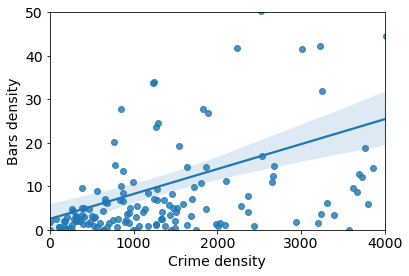

In [231]:
#plt.figure(figsize=(40, 6000))
seaborn.regplot(x="Crime density", y="Bars density", data=db_nh)
plt.ylim(0, 50)
plt.xlim(0, 4000)
plt.savefig("bars.png", bbox_inches="tight")

It looks weird. There is no sufficient correlation, but picture is enough to illustrate the general dependency: the more the bars - the more the crimes. It is well known that the correlation don't means causation, that's why the "Bars density" is placed at y-axis. The bars don't causes crimes. The crimes causes the bars!
If go more serious, this example was pretty unsuccessful. But there is a rule: the bars, restaurants and other public places are the result of civil activity. The more activity - the more the bars. But the criminal activity is the civil activity too. That's why the number of bars have a weak correlation with the number of crimes. And if the crime exceeds it's limit, it poisons the rest of civil activity to death. 




---

The mandatory part of the job is done, so let's pay attention to my favorite matter. The Fire, right.

---
# Arsons!
---

In [234]:
df_t=df[df['CRIME_TYPE']=='Arson']
df_by_nh = df_t.groupby(['NTA'])['NTA'].count().reset_index(name='Arsons Count')
df_by_nh

,NTA,Arsons Count
0,Allerton-Pelham Gardens,7
1,Annadale-Huguenot-Prince's Bay-Eltingville,4
2,Arden Heights,5
3,Astoria,17
4,Baisley Park,27
...,...,...
183,Yorkville,17
184,park-cemetery-etc-Bronx,12
185,park-cemetery-etc-Brooklyn,10
186,park-cemetery-etc-Manhattan,4


In [235]:
df_nh = pd.merge(df_nh, df_by_nh, on="NTA", how ="outer")
#df_nh['Arsons density'] = df_nh['Arsons count'] / df_nh['AREA']
df_nh

,Cluster,NTA,BORO,AREA,Latitude,Longitude,Total number of crimes,Crime density,Thefts Count,Thefts density,...,Arsons density,Sex Crimes Count,Sex Crimes density,Vehicle Violations Count,Vehicle Violations density,Drug Violations Count,Drug Violations density,Misc Count,Misc density,Arsons Count_y
0,2,Borough Park,Brooklyn,1.937164,40.630950,-73.988661,8245,945.611604,3289,377.212440,...,1.261580,334.0,38.306158,432.0,49.545690,343.0,39.338360,266,30.507300,11.0
1,2,Murray Hill,Queens,1.882758,40.768352,-73.809546,4746,560.043378,1771,208.983738,...,0.472013,0.0,0.000000,158.0,18.644512,35.0,4.130113,197,23.246638,4.0
2,1,East Elmhurst,Queens,0.707603,40.763352,-73.868396,4533,1423.260281,1392,437.056764,...,2.197843,1.0,0.313978,289.0,90.739515,139.0,43.642881,221,69.389041,7.0
3,1,Hollis,Queens,0.820986,40.710639,-73.761137,3780,1022.926716,1053,284.958157,...,1.623693,0.0,0.000000,97.0,26.249707,39.0,10.554006,253,68.465730,6.0
4,1,Manhattanville,Manhattan,0.381911,40.817976,-73.953782,8370,4869.129195,2351,1367.661020,...,8.144302,180.0,104.712456,220.0,127.981890,586.0,340.897217,431,250.728158,14.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,2,Ozone Park,Queens,0.897356,40.675599,-73.847049,4185,1036.142009,1758,435.253919,...,2.971017,0.0,0.000000,121.0,29.957750,75.0,18.568853,182,45.060417,12.0
191,2,Lindenwood-Howard Beach,Queens,2.315734,40.658170,-73.844885,3514,337.133243,1504,144.293796,...,1.343160,0.0,0.000000,108.0,10.361523,74.0,7.099562,163,15.638224,14.0
192,1,University Heights-Morris Heights,Bronx,0.762436,40.852522,-73.915974,14217,4142.792596,3448,1004.737207,...,9.907501,0.0,0.000000,370.0,107.816928,714.0,208.057531,612,178.335026,34.0
193,1,New Brighton-Silver Lake,Staten Island,1.690816,40.630050,-74.102861,3514,461.736096,1091,143.356312,...,0.919793,0.0,0.000000,185.0,24.308816,71.0,9.329329,138,18.133062,7.0


In [236]:
df_nh['Arsons Count'].fillna(0.0, inplace = True)
df_nh['Arsons density'] = df_nh['Arsons Count'].astype('float') / (df_nh['AREA'] * period)
df_nh[df_nh['Arsons Count'].isnull()]


KeyError: 'Arsons Count'

In [237]:
ny_arsons_map = folium.Map(location=[center_lat, center_lon], tiles='cartodbpositron', zoom_start=10.5)

folium.Choropleth(
    geo_data=geodata,
    data=df_nh,
    columns=['NTA', 'Arsons density'],
    key_on='feature.properties.ntaname',
    fill_color='YlOrRd',
    fill_opacity=0.6, 
    line_opacity=0.2,
    legend_name='Arsons per square mile per year',
    highlight = True
).add_to(ny_arsons_map)


for lat, lng, nta, boro, density in zip(df_nh['Latitude'], df_nh['Longitude'], 
                                  df_nh['NTA'], df_nh['BORO'], 
                                  df_nh['Arsons density']):
    color = 'brown'
    label = "<b>{}, {}</b><br/>{} arsons per sq mile per year".format(nta, boro, int(density))
    label = folium.Html(label, script=True)
    label = folium.Popup(label, parse_html=True,max_width=500)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color=color,
        fill=True,
        fill_color=color,
        opacity=0.1,
        fill_opacity=0.0,
        parse_html=False).add_to(ny_arsons_map)  
ny_arsons_map.save(outfile="arsons.html")
ny_arsons_map

The guys from East Harlem are in competition with their collegues from Bronx. Twenty arsons per year, that's the spirit!

But look at that, who's hiding on the south of Manhattan? Lower East Side, looks interesting. Their total rate of crime is on of the lowest all over the Manhattan, however these shy boys definitely have some matches in their pockets. 17.8 arsons per square mile, go Lower East Side!

Staten Island demonstrates the total lack of motivation as always. What's going on at Staten Island? The people of this boro are unable to make even one tiny little fire per year. Are they alive in there at all?

And there is one more thing can be noticed on these maps. The Maspeth Creek. It works like a natural barrier on the way of hordes of brooklynites rushing north. The Police of Queens knows the art of fortification.

---


## Conclusion:

The conclusion is pretty simple: if you looking for a house and want to live in safe and silent place, choose Staten Island. If you get bored you always can make a tour. The adventure is always waiting for you in NY City. The Bronx is ready to give you a good fight, and after that you can participate in some Harlem activities. But hold your wallet when going home through Manhattan. And if you need some fire - look at Lower East Side. Everyone there have some matches for you.

#### Disclaimer:
The author is not a criminal and never been.  
The author is not a law enforcement officer and never been.  
The author is not an expert in data science and never been.  
The author have never been in NY.  
The goal of this survey is to play a little bit with some data-science tools which the author accidentally found.  
The author waives any responsibility of any losses or revenues occured as the result of proper or inproper use of this "survey".

#### References:

New York City Opendata:
* [NYPD Complaint Data Historic](https://data.cityofnewyork.us/Public-Safety/NYPD-Complaint-Data-Historic/qgea-i56i)
* [Neighborhood Tabulation Areas](https://data.cityofnewyork.us/City-Government/Neighborhood-Tabulation-Areas-NTA-/cpf4-rkhq)

Tools:
* [Pandas User Guide](https://pandas.pydata.org/docs/user_guide/)
* [Folium documentation](https://python-visualization.github.io/folium/)

# SEX

In [50]:
df_t=df[df['CRIME_TYPE']=='Sex-related']
df_by_nh = df_t.groupby(['NTA'])['NTA'].count().reset_index(name='Sex Crimes Count')
df_nh = pd.merge(df_nh, df_by_nh, on="NTA", how ="outer")
df_nh['Sex Crimes Count'].fillna(0.0, inplace = True)
df_nh['Sex Crimes density'] = df_nh['Sex Crimes Count'].astype('float') / (df_nh['AREA'] * period)
df_nh[df_nh['Sex Crimes Count'].isnull()]
df_nh

,NTA,BORO,AREA,Latitude,Longitude,Total number of crimes,Crime density,Thefts Count,Thefts density,Violence Count,Violence density,Acts of disorder Count,Disorder density,Arsons Count,Arsons density,Sex Crimes Count,Sex Crimes density
0,Borough Park,Brooklyn,1.937164,40.630950,-73.988661,8245,945.611604,3289,377.212440,2245,257.477022,1325,151.963053,11.0,1.261580,334.0,38.306158
1,Murray Hill,Queens,1.882758,40.768352,-73.809546,4746,560.043378,1771,208.983738,1731,204.263609,850,100.302754,4.0,0.472013,0.0,0.000000
2,East Elmhurst,Queens,0.707603,40.763352,-73.868396,4533,1423.260281,1392,437.056764,1751,549.774708,733,230.145552,7.0,2.197843,1.0,0.313978
3,Hollis,Queens,0.820986,40.710639,-73.761137,3780,1022.926716,1053,284.958157,1479,400.240374,853,230.835050,6.0,1.623693,0.0,0.000000
4,Manhattanville,Manhattan,0.381911,40.817976,-73.953782,8370,4869.129195,2351,1367.661020,2788,1621.879593,1800,1047.124558,14.0,8.144302,180.0,104.712456
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,Ozone Park,Queens,0.897356,40.675599,-73.847049,4185,1036.142009,1758,435.253919,1222,302.548515,815,201.781538,12.0,2.971017,0.0,0.000000
191,Lindenwood-Howard Beach,Queens,2.315734,40.658170,-73.844885,3514,337.133243,1504,144.293796,963,92.390243,688,66.006736,14.0,1.343160,0.0,0.000000
192,University Heights-Morris Heights,Bronx,0.762436,40.852522,-73.915974,14217,4142.792596,3448,1004.737207,6399,1864.650054,2640,769.288349,34.0,9.907501,0.0,0.000000
193,New Brighton-Silver Lake,Staten Island,1.690816,40.630050,-74.102861,3514,461.736096,1091,143.356312,1278,167.927926,744,97.760858,7.0,0.919793,0.0,0.000000


# Vehicle

In [51]:
df_t=df[df['CRIME_TYPE']=='Vehicle']
df_by_nh = df_t.groupby(['NTA'])['NTA'].count().reset_index(name='Vehicle Violations Count')
df_nh = pd.merge(df_nh, df_by_nh, on="NTA", how ="outer")
df_nh['Vehicle Violations Count'].fillna(0.0, inplace = True)
df_nh['Vehicle Violations density'] = df_nh['Vehicle Violations Count'].astype('float') / (df_nh['AREA'] * period)
df_nh[df_nh['Vehicle Violations Count'].isnull()]
df_nh.head(10)

,NTA,BORO,AREA,Latitude,Longitude,Total number of crimes,Crime density,Thefts Count,Thefts density,Violence Count,Violence density,Acts of disorder Count,Disorder density,Arsons Count,Arsons density,Sex Crimes Count,Sex Crimes density,Vehicle Violations Count,Vehicle Violations density
0,Borough Park,Brooklyn,1.937164,40.630950,-73.988661,8245,945.611604,3289,377.212440,2245,257.477022,1325,151.963053,11.0,1.261580,334.0,38.306158,432.0,49.545690
1,Murray Hill,Queens,1.882758,40.768352,-73.809546,4746,560.043378,1771,208.983738,1731,204.263609,850,100.302754,4.0,0.472013,0.0,0.000000,158.0,18.644512
2,East Elmhurst,Queens,0.707603,40.763352,-73.868396,4533,1423.260281,1392,437.056764,1751,549.774708,733,230.145552,7.0,2.197843,1.0,0.313978,289.0,90.739515
3,Hollis,Queens,0.820986,40.710639,-73.761137,3780,1022.926716,1053,284.958157,1479,400.240374,853,230.835050,6.0,1.623693,0.0,0.000000,97.0,26.249707
4,Manhattanville,Manhattan,0.381911,40.817976,-73.953782,8370,4869.129195,2351,1367.661020,2788,1621.879593,1800,1047.124558,14.0,8.144302,180.0,104.712456,220.0,127.981890
5,Homecrest,Brooklyn,1.075814,40.599954,-73.964334,5657,1168.254551,2252,465.071460,1441,297.587910,956,197.428204,4.0,0.826059,288.0,59.476279,328.0,67.736873
6,Westchester-Unionport,Bronx,0.858916,40.832100,-73.848643,6125,1584.322914,1872,484.220815,2360,610.449319,1352,349.715033,18.0,4.655969,0.0,0.000000,139.0,35.954430
7,Pelham Bay-Country Club-City Island,Bronx,1.439628,40.846568,-73.806537,3605,556.343872,1167,180.098002,1327,204.790102,831,128.244593,5.0,0.771628,0.0,0.000000,79.0,12.191724
8,Schuylerville-Throgs Neck-Edgewater Park,Bronx,3.172347,40.823332,-73.823588,9315,652.364858,2600,182.087883,3441,240.986310,1874,131.243343,11.0,0.770372,249.0,17.438417,378.0,26.472777
9,Fresh Meadows-Utopia,Queens,0.996286,40.734894,-73.783717,1823,406.528642,1016,226.567801,348,77.603932,330,73.589935,0.0,0.000000,0.0,0.000000,52.0,11.595990


# Drugs

In [52]:
df_t=df[df['CRIME_TYPE']=='Drug-related']
df_by_nh = df_t.groupby(['NTA'])['NTA'].count().reset_index(name='Drug Violations Count')
df_nh = pd.merge(df_nh, df_by_nh, on="NTA", how ="outer")
df_nh['Drug Violations Count'].fillna(0.0, inplace = True)
df_nh['Drug Violations density'] = df_nh['Drug Violations Count'].astype('float') / (df_nh['AREA'] * period)
df_nh[df_nh['Drug Violations Count'].isnull()]
df_nh.head(10)

,NTA,BORO,AREA,Latitude,Longitude,Total number of crimes,Crime density,Thefts Count,Thefts density,Violence Count,...,Acts of disorder Count,Disorder density,Arsons Count,Arsons density,Sex Crimes Count,Sex Crimes density,Vehicle Violations Count,Vehicle Violations density,Drug Violations Count,Drug Violations density
0,Borough Park,Brooklyn,1.937164,40.630950,-73.988661,8245,945.611604,3289,377.212440,2245,...,1325,151.963053,11.0,1.261580,334.0,38.306158,432.0,49.545690,343.0,39.338360
1,Murray Hill,Queens,1.882758,40.768352,-73.809546,4746,560.043378,1771,208.983738,1731,...,850,100.302754,4.0,0.472013,0.0,0.000000,158.0,18.644512,35.0,4.130113
2,East Elmhurst,Queens,0.707603,40.763352,-73.868396,4533,1423.260281,1392,437.056764,1751,...,733,230.145552,7.0,2.197843,1.0,0.313978,289.0,90.739515,139.0,43.642881
3,Hollis,Queens,0.820986,40.710639,-73.761137,3780,1022.926716,1053,284.958157,1479,...,853,230.835050,6.0,1.623693,0.0,0.000000,97.0,26.249707,39.0,10.554006
4,Manhattanville,Manhattan,0.381911,40.817976,-73.953782,8370,4869.129195,2351,1367.661020,2788,...,1800,1047.124558,14.0,8.144302,180.0,104.712456,220.0,127.981890,586.0,340.897217
5,Homecrest,Brooklyn,1.075814,40.599954,-73.964334,5657,1168.254551,2252,465.071460,1441,...,956,197.428204,4.0,0.826059,288.0,59.476279,328.0,67.736873,181.0,37.379189
6,Westchester-Unionport,Bronx,0.858916,40.832100,-73.848643,6125,1584.322914,1872,484.220815,2360,...,1352,349.715033,18.0,4.655969,0.0,0.000000,139.0,35.954430,167.0,43.197049
7,Pelham Bay-Country Club-City Island,Bronx,1.439628,40.846568,-73.806537,3605,556.343872,1167,180.098002,1327,...,831,128.244593,5.0,0.771628,0.0,0.000000,79.0,12.191724,105.0,16.204190
8,Schuylerville-Throgs Neck-Edgewater Park,Bronx,3.172347,40.823332,-73.823588,9315,652.364858,2600,182.087883,3441,...,1874,131.243343,11.0,0.770372,249.0,17.438417,378.0,26.472777,419.0,29.344163
9,Fresh Meadows-Utopia,Queens,0.996286,40.734894,-73.783717,1823,406.528642,1016,226.567801,348,...,330,73.589935,0.0,0.000000,0.0,0.000000,52.0,11.595990,13.0,2.898997


# Miscellaneous

In [53]:
df_t=df[df['CRIME_TYPE']=='Miscellaneous']
df_by_nh = df_t.groupby(['NTA'])['NTA'].count().reset_index(name='Misc Count')
df_nh = pd.merge(df_nh, df_by_nh, on="NTA", how ="outer")
df_nh['Misc Count'].fillna(0.0, inplace = True)
df_nh['Misc density'] = df_nh['Misc Count'].astype('float') / (df_nh['AREA'] * period)
df_nh[df_nh['Misc Count'].isnull()]
df_nh.head(10)

,NTA,BORO,AREA,Latitude,Longitude,Total number of crimes,Crime density,Thefts Count,Thefts density,Violence Count,...,Arsons Count,Arsons density,Sex Crimes Count,Sex Crimes density,Vehicle Violations Count,Vehicle Violations density,Drug Violations Count,Drug Violations density,Misc Count,Misc density
0,Borough Park,Brooklyn,1.937164,40.630950,-73.988661,8245,945.611604,3289,377.212440,2245,...,11.0,1.261580,334.0,38.306158,432.0,49.545690,343.0,39.338360,266,30.507300
1,Murray Hill,Queens,1.882758,40.768352,-73.809546,4746,560.043378,1771,208.983738,1731,...,4.0,0.472013,0.0,0.000000,158.0,18.644512,35.0,4.130113,197,23.246638
2,East Elmhurst,Queens,0.707603,40.763352,-73.868396,4533,1423.260281,1392,437.056764,1751,...,7.0,2.197843,1.0,0.313978,289.0,90.739515,139.0,43.642881,221,69.389041
3,Hollis,Queens,0.820986,40.710639,-73.761137,3780,1022.926716,1053,284.958157,1479,...,6.0,1.623693,0.0,0.000000,97.0,26.249707,39.0,10.554006,253,68.465730
4,Manhattanville,Manhattan,0.381911,40.817976,-73.953782,8370,4869.129195,2351,1367.661020,2788,...,14.0,8.144302,180.0,104.712456,220.0,127.981890,586.0,340.897217,431,250.728158
5,Homecrest,Brooklyn,1.075814,40.599954,-73.964334,5657,1168.254551,2252,465.071460,1441,...,4.0,0.826059,288.0,59.476279,328.0,67.736873,181.0,37.379189,207,42.748576
6,Westchester-Unionport,Bronx,0.858916,40.832100,-73.848643,6125,1584.322914,1872,484.220815,2360,...,18.0,4.655969,0.0,0.000000,139.0,35.954430,167.0,43.197049,217,56.130298
7,Pelham Bay-Country Club-City Island,Bronx,1.439628,40.846568,-73.806537,3605,556.343872,1167,180.098002,1327,...,5.0,0.771628,0.0,0.000000,79.0,12.191724,105.0,16.204190,91,14.043632
8,Schuylerville-Throgs Neck-Edgewater Park,Bronx,3.172347,40.823332,-73.823588,9315,652.364858,2600,182.087883,3441,...,11.0,0.770372,249.0,17.438417,378.0,26.472777,419.0,29.344163,343,24.021594
9,Fresh Meadows-Utopia,Queens,0.996286,40.734894,-73.783717,1823,406.528642,1016,226.567801,348,...,0.0,0.000000,0.0,0.000000,52.0,11.595990,13.0,2.898997,64,14.271987


# Drop excesses

In [57]:

df_clustering = df_nh.drop('NTA', 1)
df_clustering = df_clustering.drop('BORO', 1)
df_clustering = df_clustering.drop('AREA', 1)
df_clustering = df_clustering.drop('Latitude', 1)
df_clustering = df_clustering.drop('Longitude', 1)
df_clustering = df_clustering.drop('Total number of crimes', 1)
df_clustering = df_clustering.drop('Thefts Count', 1)
df_clustering = df_clustering.drop('Violence Count', 1)
df_clustering = df_clustering.drop('Arsons Count', 1)
df_clustering = df_clustering.drop('Acts of disorder Count', 1)
df_clustering = df_clustering.drop('Sex Crimes Count', 1)
df_clustering = df_clustering.drop('Vehicle Violations Count', 1)
df_clustering = df_clustering.drop('Drug Violations Count', 1)
df_clustering = df_clustering.drop('Misc Count', 1)




In [58]:
df_clustering.head()

,Crime density,Thefts density,Violence density,Disorder density,Arsons density,Sex Crimes density,Vehicle Violations density,Drug Violations density,Misc density
0,945.611604,377.212440,257.477022,151.963053,1.261580,38.306158,49.545690,39.338360,30.507300
1,560.043378,208.983738,204.263609,100.302754,0.472013,0.000000,18.644512,4.130113,23.246638
2,1423.260281,437.056764,549.774708,230.145552,2.197843,0.313978,90.739515,43.642881,69.389041
3,1022.926716,284.958157,400.240374,230.835050,1.623693,0.000000,26.249707,10.554006,68.465730
4,4869.129195,1367.661020,1621.879593,1047.124558,8.144302,104.712456,127.981890,340.897217,250.728158


In [59]:
df_clustering=df_clustering.div(df_clustering['Crime density'], axis=0)
df_clustering.head()

,Crime density,Thefts density,Violence density,Disorder density,Arsons density,Sex Crimes density,Vehicle Violations density,Drug Violations density,Misc density
0,1.0,0.398908,0.272286,0.160703,0.001334,0.040509,0.052395,0.041601,0.032262
1,1.0,0.373156,0.364728,0.179098,0.000843,0.000000,0.033291,0.007375,0.041509
2,1.0,0.307081,0.386278,0.161703,0.001544,0.000221,0.063755,0.030664,0.048754
3,1.0,0.278571,0.391270,0.225661,0.001587,0.000000,0.025661,0.010317,0.066931
4,1.0,0.280884,0.333094,0.215054,0.001673,0.021505,0.026284,0.070012,0.051493


In [60]:
df_clustering = df_clustering.drop('Crime density', 1)
df_clustering.head()

,Thefts density,Violence density,Disorder density,Arsons density,Sex Crimes density,Vehicle Violations density,Drug Violations density,Misc density
0,0.398908,0.272286,0.160703,0.001334,0.040509,0.052395,0.041601,0.032262
1,0.373156,0.364728,0.179098,0.000843,0.000000,0.033291,0.007375,0.041509
2,0.307081,0.386278,0.161703,0.001544,0.000221,0.063755,0.030664,0.048754
3,0.278571,0.391270,0.225661,0.001587,0.000000,0.025661,0.010317,0.066931
4,0.280884,0.333094,0.215054,0.001673,0.021505,0.026284,0.070012,0.051493


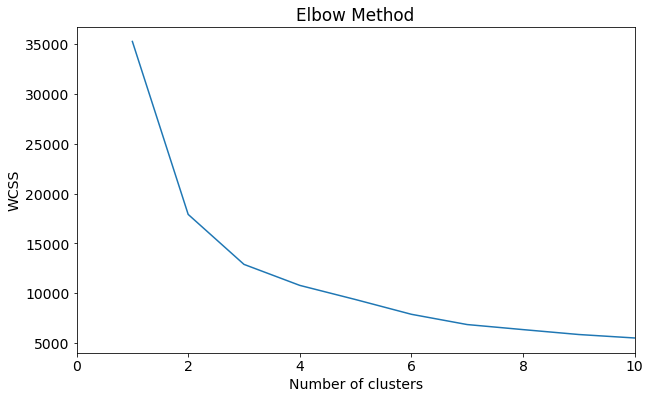

In [213]:
from sklearn.cluster import KMeans

wcss = []
for i in range(1, 11):
    kkmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kkmeans.fit(df_clustering)
    wcss.append(kkmeans.inertia_)
plt.figure(figsize=(10,6))
plt.plot(range(1, 11), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.xlim(0,10)
plt.savefig('Elbow.png', bbox_inches="tight")

plt.show()


In [214]:
# set number of clusters
kclusters = 3

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(df_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([2, 2, 1, 1, 1, 2, 1, 1, 1, 0])

In [215]:
kmeans.cluster_centers_

array([[6.66133815e-16, 5.49877221e+01, 2.35571160e+01, 1.32205152e+01,
        8.63536195e-02, 1.21268415e+00, 2.41375947e+00, 1.74942677e+00,
        2.77242266e+00],
       [1.00000000e+00, 2.78188430e+01, 3.72975309e+01, 1.91308378e+01,
        2.06138444e-01, 1.03728968e+00, 3.62087280e+00, 4.61438936e+00,
        6.27409793e+00],
       [2.00000000e+00, 3.97566657e+01, 3.02725057e+01, 1.77189921e+01,
        1.40803779e-01, 1.01984707e+00, 3.74042188e+00, 3.05924830e+00,
        4.29151549e+00]])

In [64]:
print(len(kmeans.labels_))
kmeans.labels_

195


array([2, 2, 1, 1, 1, 2, 1, 1, 1, 0, 1, 1, 2, 2, 2, 1, 1, 2, 2, 2, 1, 1,
       1, 2, 2, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 2, 1, 2, 2, 1, 1, 2, 1, 2,
       2, 0, 2, 1, 1, 1, 1, 2, 1, 1, 2, 1, 2, 0, 1, 1, 1, 1, 1, 2, 2, 1,
       2, 1, 2, 2, 2, 2, 2, 1, 1, 1, 1, 2, 2, 1, 0, 2, 0, 0, 0, 2, 1, 1,
       1, 1, 2, 2, 0, 2, 1, 1, 1, 2, 2, 0, 1, 1, 2, 1, 1, 0, 2, 1, 1, 1,
       1, 0, 2, 2, 1, 1, 0, 1, 1, 1, 1, 0, 2, 0, 0, 0, 0, 1, 0, 1, 1, 1,
       2, 1, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 2, 0, 2, 2, 1,
       0, 1, 2, 2, 0, 1, 2, 1, 2, 1, 2, 2, 1, 0, 2, 2, 1, 0, 1, 2, 2, 2,
       2, 2, 2, 1, 2, 0, 0, 1, 1, 2, 2, 1, 2, 1, 2, 2, 1, 1, 1])

In [65]:
#df_nh = df_nh.drop('Cluster', 1)
df_nh.insert(0, 'Cluster', kmeans.labels_)
df_nh

,Cluster,NTA,BORO,AREA,Latitude,Longitude,Total number of crimes,Crime density,Thefts Count,Thefts density,...,Arsons Count,Arsons density,Sex Crimes Count,Sex Crimes density,Vehicle Violations Count,Vehicle Violations density,Drug Violations Count,Drug Violations density,Misc Count,Misc density
0,2,Borough Park,Brooklyn,1.937164,40.630950,-73.988661,8245,945.611604,3289,377.212440,...,11.0,1.261580,334.0,38.306158,432.0,49.545690,343.0,39.338360,266,30.507300
1,2,Murray Hill,Queens,1.882758,40.768352,-73.809546,4746,560.043378,1771,208.983738,...,4.0,0.472013,0.0,0.000000,158.0,18.644512,35.0,4.130113,197,23.246638
2,1,East Elmhurst,Queens,0.707603,40.763352,-73.868396,4533,1423.260281,1392,437.056764,...,7.0,2.197843,1.0,0.313978,289.0,90.739515,139.0,43.642881,221,69.389041
3,1,Hollis,Queens,0.820986,40.710639,-73.761137,3780,1022.926716,1053,284.958157,...,6.0,1.623693,0.0,0.000000,97.0,26.249707,39.0,10.554006,253,68.465730
4,1,Manhattanville,Manhattan,0.381911,40.817976,-73.953782,8370,4869.129195,2351,1367.661020,...,14.0,8.144302,180.0,104.712456,220.0,127.981890,586.0,340.897217,431,250.728158
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,2,Ozone Park,Queens,0.897356,40.675599,-73.847049,4185,1036.142009,1758,435.253919,...,12.0,2.971017,0.0,0.000000,121.0,29.957750,75.0,18.568853,182,45.060417
191,2,Lindenwood-Howard Beach,Queens,2.315734,40.658170,-73.844885,3514,337.133243,1504,144.293796,...,14.0,1.343160,0.0,0.000000,108.0,10.361523,74.0,7.099562,163,15.638224
192,1,University Heights-Morris Heights,Bronx,0.762436,40.852522,-73.915974,14217,4142.792596,3448,1004.737207,...,34.0,9.907501,0.0,0.000000,370.0,107.816928,714.0,208.057531,612,178.335026
193,1,New Brighton-Silver Lake,Staten Island,1.690816,40.630050,-74.102861,3514,461.736096,1091,143.356312,...,7.0,0.919793,0.0,0.000000,185.0,24.308816,71.0,9.329329,138,18.133062


In [146]:
crime_map = folium.Map(location=[center_lat, center_lon], tiles='cartodbpositron', zoom_start=10.5)

folium.Choropleth(
    geo_data=geodata,
    data=df_nh,
    columns=['NTA', 'Crime density'],
    key_on='feature.properties.ntaname',
    fill_color='YlOrRd',
    fill_opacity=0.6, 
    line_opacity=0.2,
    legend_name='Crimes per square mile per year',
    highlight = True
).add_to(crime_map)


rainbow = ['blue', 'orangered', 'gray' ]
cluster_names = ['Thiefs','Thugs','Regular guys']
for lat, lng, nta, boro, density, cluster in zip(df_nh['Latitude'], df_nh['Longitude'], 
                                  df_nh['NTA'], df_nh['BORO'], 
                                  df_nh['Crime density'], df_nh['Cluster']):
    color = rainbow[cluster],
    label = "<b>{}, {}</b><br/>{} violations per sq mile per year<br/>profile of criminals: <b>{}</b>".format(nta, 
                                                                                  boro, 
                                                                                  int(density), 
                                                                                  cluster_names[cluster])
    label = folium.Html(label, script=True)
    label = folium.Popup(label, parse_html=True,max_width=500)
    folium.CircleMarker(
        [lat, lng],
        radius=3,
        popup=label,
        color=color,
        fill=True,
        fill_color=color,
        opacity=0.8,
        fill_opacity=0.8,
        parse_html=False).add_to(crime_map)  

crime_map.save(outfile= "cluster.html")
crime_map


In [68]:
df_clustering = df_clustering * 100

In [69]:
df_clustering

,Thefts density,Violence density,Disorder density,Arsons density,Sex Crimes density,Vehicle Violations density,Drug Violations density,Misc density
0,39.890843,27.228623,16.070346,0.133414,4.050940,5.239539,4.160097,3.226198
1,37.315634,36.472819,17.909819,0.084282,0.000000,3.329119,0.737463,4.150864
2,30.708140,38.627840,16.170307,0.154423,0.022060,6.375469,3.066402,4.875358
3,27.857143,39.126984,22.566138,0.158730,0.000000,2.566138,1.031746,6.693122
4,28.088411,33.309438,21.505376,0.167264,2.150538,2.628435,7.001195,5.149343
...,...,...,...,...,...,...,...,...
190,42.007168,29.199522,19.474313,0.286738,0.000000,2.891278,1.792115,4.348865
191,42.800228,27.404667,19.578828,0.398406,0.000000,3.073421,2.105862,4.638589
192,24.252655,45.009496,18.569318,0.239150,0.000000,2.602518,5.022157,4.304706
193,31.047240,36.368810,21.172453,0.199203,0.000000,5.264656,2.020489,3.927149


In [70]:
df_clustering.insert(0, 'Cluster', kmeans.labels_)

In [71]:
df_clustering.rename(columns={"Thefts density":"Thefts", "Violence density":"Violence", "Disorder density":"Disorder", "Arsons density":"Arsons", "Sex Crimes density":"Sex Crimes", "Vehicle Violations density":"Vehicle", "Drug Violations density":"Drug Crimes", "Misc density":"Miscellaneous"}, inplace=True)

In [72]:
df_clustering

,Cluster,Thefts,Violence,Disorder,Arsons,Sex Crimes,Vehicle,Drug Crimes,Miscellaneous
0,2,39.890843,27.228623,16.070346,0.133414,4.050940,5.239539,4.160097,3.226198
1,2,37.315634,36.472819,17.909819,0.084282,0.000000,3.329119,0.737463,4.150864
2,1,30.708140,38.627840,16.170307,0.154423,0.022060,6.375469,3.066402,4.875358
3,1,27.857143,39.126984,22.566138,0.158730,0.000000,2.566138,1.031746,6.693122
4,1,28.088411,33.309438,21.505376,0.167264,2.150538,2.628435,7.001195,5.149343
...,...,...,...,...,...,...,...,...,...
190,2,42.007168,29.199522,19.474313,0.286738,0.000000,2.891278,1.792115,4.348865
191,2,42.800228,27.404667,19.578828,0.398406,0.000000,3.073421,2.105862,4.638589
192,1,24.252655,45.009496,18.569318,0.239150,0.000000,2.602518,5.022157,4.304706
193,1,31.047240,36.368810,21.172453,0.199203,0.000000,5.264656,2.020489,3.927149


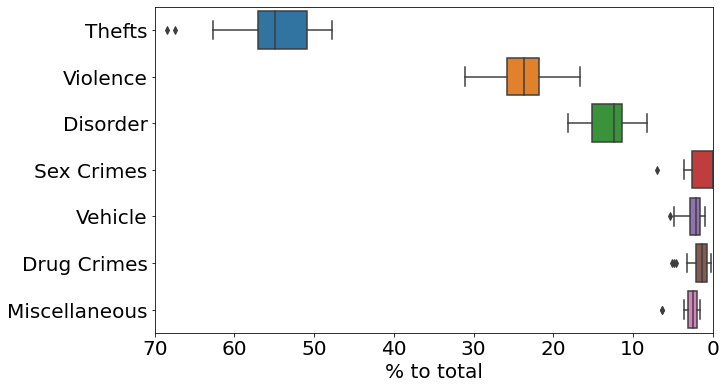

In [197]:
cluster0 = df_clustering[df_clustering['Cluster'] == 0][['Thefts', 'Violence', 'Disorder','Sex Crimes','Vehicle','Drug Crimes','Miscellaneous']]
plt.figure(figsize=(10,6))
seaborn.boxplot(data=cluster0, orient="h")
plt.xlim(70, 0)
plt.xlabel('% to total')
plt.rcParams.update({'font.size': 20})

plt.savefig('Thiefs.png', bbox_inches="tight")

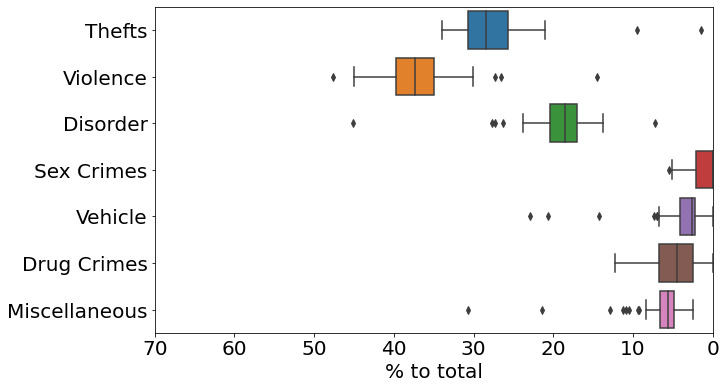

In [198]:
cluster1 = df_clustering[df_clustering['Cluster'] == 1][['Thefts', 'Violence', 'Disorder','Sex Crimes','Vehicle','Drug Crimes','Miscellaneous']]
plt.figure(figsize=(10,6))
seaborn.boxplot(data=cluster1, orient="h")
plt.xlim(70, 0)
plt.xlabel('% to total')
plt.rcParams.update({'font.size': 20})

plt.savefig('Thugs.png', bbox_inches="tight")

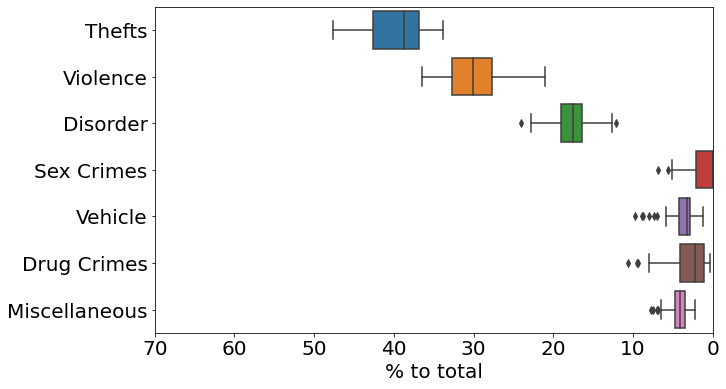

In [199]:
cluster2 = df_clustering[df_clustering['Cluster'] == 2][['Thefts', 'Violence', 'Disorder','Sex Crimes','Vehicle','Drug Crimes','Miscellaneous']]
plt.figure(figsize=(10,6))
seaborn.boxplot(data=cluster2, orient="h")
plt.xlim(70, 0)
plt.xlabel('% to total')
plt.rcParams.update({'font.size': 24})

plt.savefig('Regular.png', bbox_inches="tight")